<a href="https://colab.research.google.com/github/KaishvaShah/EE610_ImageProcessing/blob/main/EE610_Assignment4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EE610 Assignment 4
## By - Karrthik Arya (200020068) and Kaishva Chintan Shah (200020066)  

We have used Tenseflow to implement the following code

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import cv2
import os
import tensorflow as tf
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Dropout 
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import concatenate
from tensorflow.keras.losses import binary_crossentropy
import matplotlib
import matplotlib.pyplot as plt
import random
%matplotlib inline
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
import numpy as np

# Question 1

The first step we do is to load the dataset, the format of the dataset is as follows:
The dataset train_ds has 2 lists, the first list contains the images from "Tissue-Images" and the second list contains the corresponding mask images from "Binary-Mask". The images from "Binary-Mask" are read as grayscale images. We are gonna pass it as a scaled numpy array. 

In [ ]:
img_ds = []
tr_im=[]
tr_lab=[]
va_im=[]
va_lab = []
train_ds=[tr_im,tr_lab]
valid_ds=[va_im,va_lab]
for filename in os.listdir("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Training-Data/Tissue-Images/"):
  if(filename[0]=="."):
    continue
  img = cv2.imread("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Training-Data/Tissue-Images/"+filename)
  img1 = cv2.imread("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Training-Data/Binary-Mask/"+filename, 0)
  tr_im.append(img)
  tr_lab.append(img1)


train_ds[0] = np.array(train_ds[0])/255
train_ds[1] = np.array(train_ds[1])/255

The same format is followed for the test dataset as well

In [ ]:
test_ds_x = []
test_ds_y = []
for filename in os.listdir("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Test-Data/Tissue-Images/"):
  if(filename[0]=="."):
    continue
  img = cv2.imread("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Test-Data/Tissue-Images/"+filename)
  img1 = cv2.imread("/content/drive/MyDrive/Acads_IITB/MoNuSeg-Test-Data/Binary-Mask/"+filename, 0)
  test_ds_x.append(img)
  test_ds_y.append(img1)
test_ds = [np.array(test_ds_x)/255,np.array(test_ds_y)/255]

This function is to just show the images present in the training dataset. 

In [ ]:
def show_batch(dl):
    fig, ax = plt.subplots(5, 2, figsize=(20,40))
    for i in range(5):
        # ax.set_xticks([]); ax.set_yticks([])
        ax[i,0].imshow(train_ds[0][i])
        ax[i,1].imshow(train_ds[1][i], cmap="gray")
        
    fig.show()

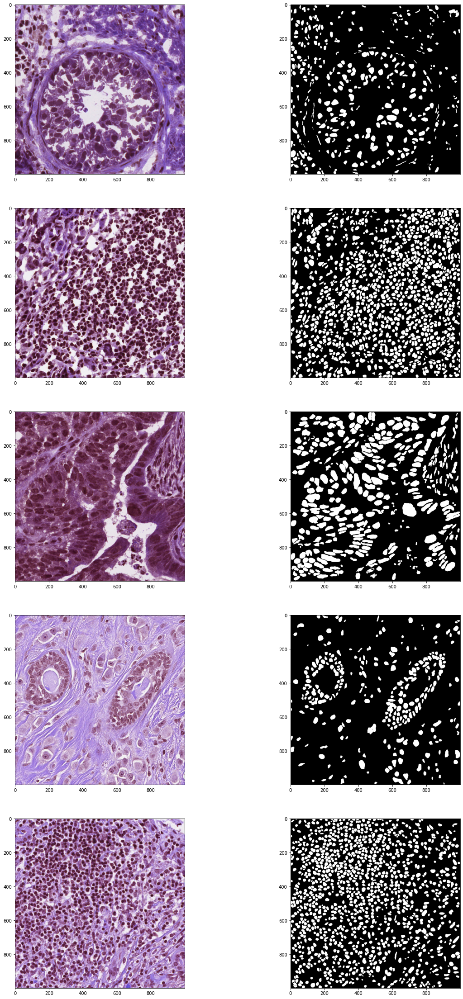

In [ ]:
show_batch(train_ds)

These are some of the test images provided with their expected mask outputs.

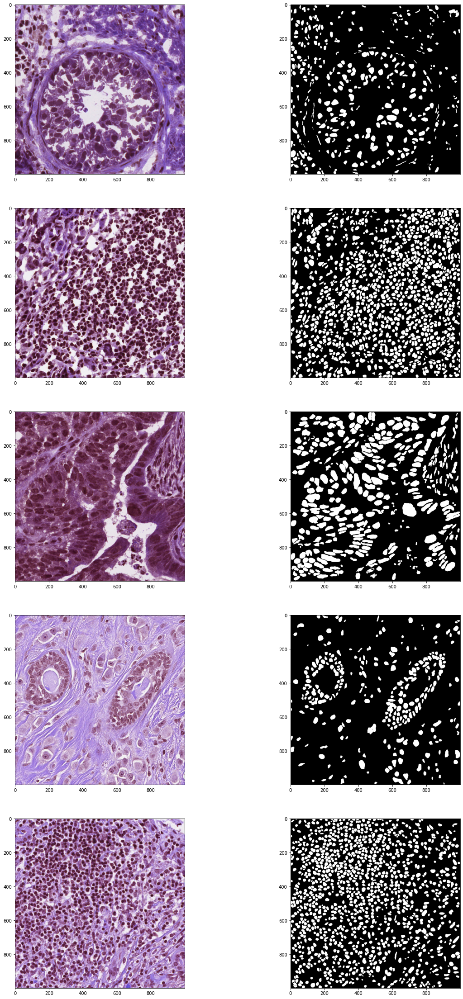

In [ ]:
show_batch(test_ds)

# Question 2

Next we make the Encoder mini block and Decoder mini block, making them separately help us in making changes to our model like the number of blocks, number of filters, etc.
 The encoder mini block has 2 steps involving convolution with a 3x3 kernel with an activation layer of ReLU followed by batch normalisation which essentially is re-centering and re-scaling the inputs. Dropout probability is the probability of exclusing a node/neuron. Max_pooling just takes the takes the maximum value of the input in the pool size (here 2x2), thus reducing the size of the output.  
The decoder mini block has a step of convolution with a kernel of size 3x3 followed by a step of concatenation with one of the encoder blocks. This then followed by 2 steps of convolution with an activation layer of ReLU.
We will now use these blocks to implement a basic UNet architecture model.

In [ ]:
def EncoderMiniBlock(inputs, n_filters=32, dropout_prob=0.1, max_pooling=True):
    conv = Conv2D(n_filters, 
                  3,  # filter size
                  activation='relu',
                  padding='same')(inputs)
    conv = Conv2D(n_filters, 
                  3,  # filter size
                  activation='relu',
                  padding='same')(conv)
  
    conv = BatchNormalization()(conv, training=False)
    if dropout_prob > 0:     
        conv = tf.keras.layers.Dropout(dropout_prob)(conv)
    if max_pooling:
        next_layer = tf.keras.layers.MaxPooling2D(pool_size = (2,2))(conv)    
    else:
        next_layer = conv
    skip_connection = conv    
    return next_layer, skip_connection

def DecoderMiniBlock(prev_layer_input, skip_layer_input, n_filters=32):
    up = Conv2DTranspose(
                 n_filters,
                 (3,3),
                 strides=(2,2),
                 padding='same')(prev_layer_input)
    merge = concatenate([up, skip_layer_input], axis=3)
    conv = Conv2D(n_filters, 
                 3,  
                 activation='relu',
                 padding='same')(merge)
    conv = Conv2D(n_filters,
                 3, 
                 activation='relu',
                 padding='same')(conv)
    return conv

So as explained above we will now use the encoder mini blocks and decoder mini blocks to implement a basic UNet model. The reference for this is https://arxiv.org/pdf/1505.04597. This is the official UNet paper. We had to resize our image to a power of 2 hence we used the resizing function of tenserflow that does bilinear interpolation.
And we had to again convert the output back to the size of the image which is 1000x1000 hence we again used the resizing function of tenseflow to achieve this.

In [ ]:
def UNetCompiled(input_size=(1000, 1000, 3), n_filters=8, n_classes=1):
    inputs = Input(input_size)
    resized = tf.keras.layers.Resizing(1024,1024) (inputs)
   
    cblock1 = EncoderMiniBlock(resized, n_filters,dropout_prob=0, max_pooling=True)
    cblock2 = EncoderMiniBlock(cblock1[0],n_filters*2,dropout_prob=0, max_pooling=True)
    cblock3 = EncoderMiniBlock(cblock2[0], n_filters*4,dropout_prob=0, max_pooling=True)
    cblock4 = EncoderMiniBlock(cblock3[0], n_filters*8,dropout_prob=0.1, max_pooling=True)
    cblock5 = EncoderMiniBlock(cblock4[0], n_filters*16, dropout_prob=0.1, max_pooling=True)
    cblock6 = EncoderMiniBlock(cblock5[0], n_filters*32, dropout_prob=0.1, max_pooling=False) 
    
    ublock5 = DecoderMiniBlock(cblock6[0], cblock5[1],  n_filters * 16)
    ublock6 = DecoderMiniBlock(ublock5, cblock4[1],  n_filters * 8)
    ublock7 = DecoderMiniBlock(ublock6, cblock3[1],  n_filters * 4)
    ublock8 = DecoderMiniBlock(ublock7, cblock2[1],  n_filters * 2)
    ublock9 = DecoderMiniBlock(ublock8, cblock1[1],  n_filters)

   
    conv9 = Conv2D(n_filters,
                 3,
                 activation='relu',
                 padding='same')(ublock9)

    conv10 = Conv2D(n_classes, 1, padding='same')(conv9)
    out = tf.keras.layers.Resizing(1000,1000)(conv10)

    model = tf.keras.Model(inputs=inputs, outputs=out)

    return model

This is implementation of dice score.

In [ ]:
import tensorflow.keras.backend as K
def dice_score(mask1, mask2, smooth=1e-6):
    mask1 = tf.cast(mask1, "float32")
    mask2 = tf.cast(mask2, "float32")
    # #print(y_true.shape)
    # #print(y_pred.shape)
    # return K.sum(K.abs(y_true * y_pred), axis=0)
    # return (2. * intersection + smooth) / (K.sum(K.square(y_true)) + K.sum(K.square(y_pred)) + smooth)

    # mask1 = mask1.numpy()
    # mask2 = mask2.numpy()
    intersect = tf.reduce_sum(mask1*mask2)
    dice = (2. * intersect ) / (tf.reduce_sum(mask1*mask1)+ tf.reduce_sum(mask2*mask2))
    # dice = round(dice, 3) # for easy reading
    return dice   

def dice_loss(y_true, y_pred):
  return 1-dice_score(y_true,y_pred)

In [ ]:
dice_score(train_ds[0][0], train_ds[0][1])

<tf.Tensor: shape=(), dtype=float64, numpy=0.8312349255892836>

In [ ]:
model = UNetCompiled()
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 1000, 1000,  0           []                               
                                 3)]                                                              
                                                                                                  
 resizing (Resizing)            (None, 1024, 1024,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 1024, 1024,   224         ['resizing[0][0]']               
                                8)                                                            

Epoch 1/20
4/4 [==============================] - 57s 880ms/step - loss: 0.9941 - accuracy: 0.7451 - dice_score: 0.0059 - val_loss: 0.9556 - val_accuracy: 0.7008 - val_dice_score: 0.0444
Epoch 2/20
4/4 [==============================] - 3s 763ms/step - loss: 0.9096 - accuracy: 0.7451 - dice_score: 0.0904 - val_loss: 0.7819 - val_accuracy: 0.7008 - val_dice_score: 0.2181
Epoch 3/20
4/4 [==============================] - 3s 738ms/step - loss: 0.7404 - accuracy: 0.5292 - dice_score: 0.2596 - val_loss: 0.6804 - val_accuracy: 0.3053 - val_dice_score: 0.3196
Epoch 4/20
4/4 [==============================] - 3s 743ms/step - loss: 0.6173 - accuracy: 0.2578 - dice_score: 0.3827 - val_loss: 0.5174 - val_accuracy: 0.3604 - val_dice_score: 0.4826
Epoch 5/20
4/4 [==============================] - 3s 748ms/step - loss: 0.5548 - accuracy: 0.3617 - dice_score: 0.4452 - val_loss: 0.5020 - val_accuracy: 0.4612 - val_dice_score: 0.4980
Epoch 6/20
4/4 [==============================] - 3s 757ms/step - los

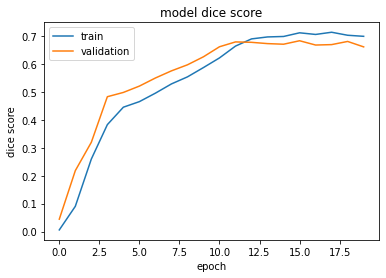

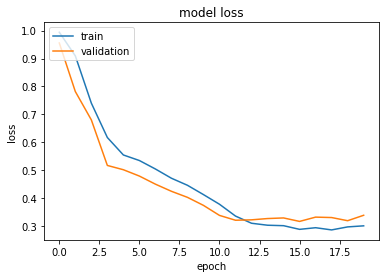

In [ ]:
model = UNetCompiled()
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = model.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=6, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
predictions = model.predict_on_batch(np.array(test_ds_x)/255)
# predictions = np.clip(np.array(predictions), 0, 1)
# predictions += 0.1

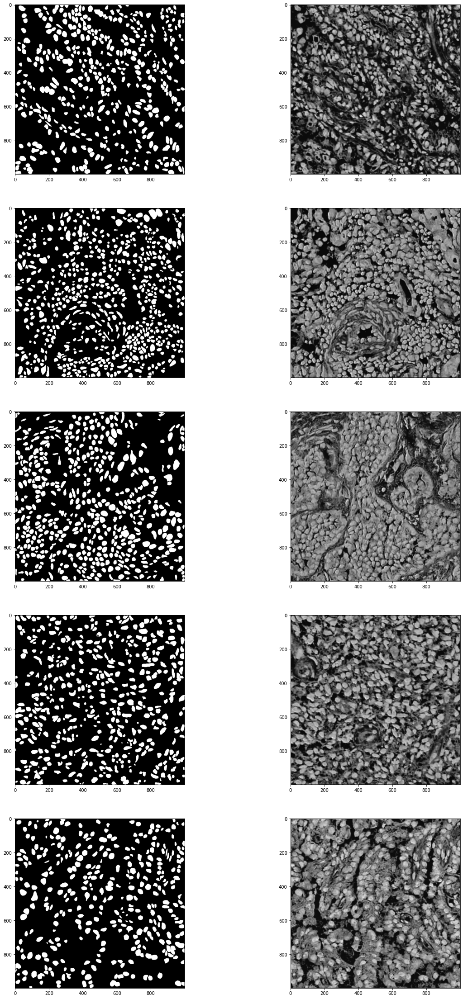

In [ ]:
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictions[i][:,:,0], cmap="gray")
    
fig.show()

In [ ]:
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictions)):
  sum_dice += dice_score(test_ds_y[i]/255, predictions[i][:,:,0])

print(sum_dice/len(predictions))

tf.Tensor(0.6596407, shape=(), dtype=float32)
tf.Tensor(0.5277114, shape=(), dtype=float32)
tf.Tensor(0.5567581, shape=(), dtype=float32)
tf.Tensor(0.5678952, shape=(), dtype=float32)
tf.Tensor(0.5105633, shape=(), dtype=float32)
tf.Tensor(0.54840606, shape=(), dtype=float32)
tf.Tensor(0.283319, shape=(), dtype=float32)
tf.Tensor(0.5338744, shape=(), dtype=float32)
tf.Tensor(0.47629154, shape=(), dtype=float32)
tf.Tensor(0.47901726, shape=(), dtype=float32)
tf.Tensor(0.48797283, shape=(), dtype=float32)
tf.Tensor(0.5604722, shape=(), dtype=float32)
tf.Tensor(0.7267613, shape=(), dtype=float32)
tf.Tensor(0.4731647, shape=(), dtype=float32)
tf.Tensor(0.52798915, shape=(), dtype=float32)


# Effect of Number of Filters


Epoch 1/20
4/4 [==============================] - 23s 2s/step - loss: 0.7651 - accuracy: 0.5219 - dice_score: 0.2349 - val_loss: 0.6122 - val_accuracy: 0.2633 - val_dice_score: 0.3878
Epoch 2/20
4/4 [==============================] - 5s 1s/step - loss: 0.6348 - accuracy: 0.2653 - dice_score: 0.3652 - val_loss: 0.5115 - val_accuracy: 0.4591 - val_dice_score: 0.4885
Epoch 3/20
4/4 [==============================] - 5s 1s/step - loss: 0.5036 - accuracy: 0.4670 - dice_score: 0.4964 - val_loss: 0.3842 - val_accuracy: 0.7507 - val_dice_score: 0.6158
Epoch 4/20
4/4 [==============================] - 5s 1s/step - loss: 0.3871 - accuracy: 0.7182 - dice_score: 0.6129 - val_loss: 0.2995 - val_accuracy: 0.7560 - val_dice_score: 0.7005
Epoch 5/20
4/4 [==============================] - 5s 1s/step - loss: 0.3312 - accuracy: 0.8145 - dice_score: 0.6688 - val_loss: 0.4096 - val_accuracy: 0.6574 - val_dice_score: 0.5904
Epoch 6/20
4/4 [==============================] - 5s 1s/step - loss: 0.3725 - accura

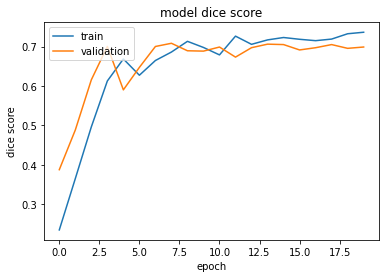

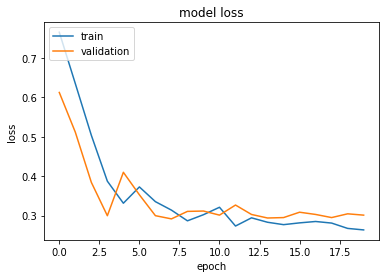

In [ ]:
model1 = UNetCompiled(n_filters = 16)
model1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = model1.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=6, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.6117261, shape=(), dtype=float32)


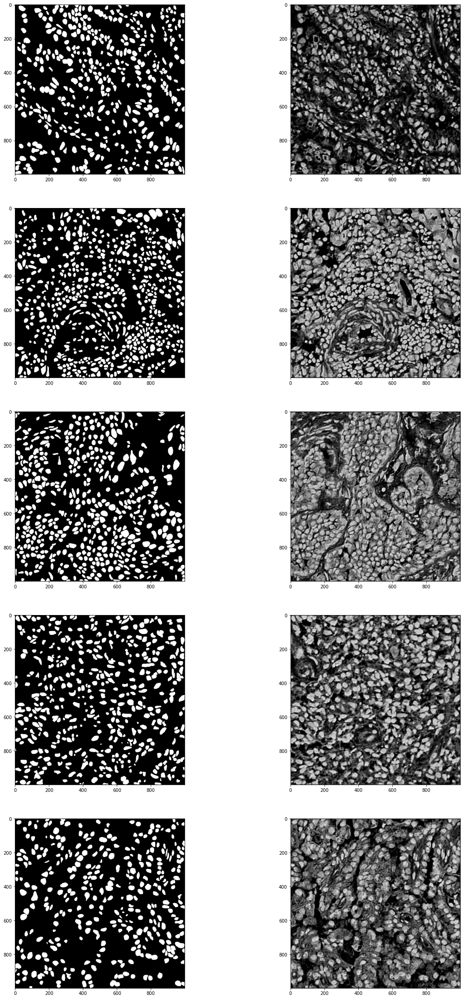

In [ ]:
predictions1 = model1.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictions1[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictions1)):
  sum_dice += dice_score(test_ds_y[i]/255, predictions1[i][:,:,0])

print(sum_dice/len(predictions1))

Epoch 1/20
4/4 [==============================] - 12s 1s/step - loss: 0.8256 - accuracy: 0.7451 - dice_score: 0.1744 - val_loss: 0.6852 - val_accuracy: 0.7008 - val_dice_score: 0.3148
Epoch 2/20
4/4 [==============================] - 3s 769ms/step - loss: 0.6718 - accuracy: 0.4929 - dice_score: 0.3282 - val_loss: 0.5721 - val_accuracy: 0.2893 - val_dice_score: 0.4279
Epoch 3/20
4/4 [==============================] - 3s 683ms/step - loss: 0.6352 - accuracy: 0.2213 - dice_score: 0.3648 - val_loss: 0.5720 - val_accuracy: 0.2743 - val_dice_score: 0.4280
Epoch 4/20
4/4 [==============================] - 3s 753ms/step - loss: 0.6199 - accuracy: 0.2972 - dice_score: 0.3801 - val_loss: 0.5562 - val_accuracy: 0.4327 - val_dice_score: 0.4438
Epoch 5/20
4/4 [==============================] - 3s 742ms/step - loss: 0.5968 - accuracy: 0.3370 - dice_score: 0.4032 - val_loss: 0.5270 - val_accuracy: 0.3117 - val_dice_score: 0.4730
Epoch 6/20
4/4 [==============================] - 3s 654ms/step - loss: 

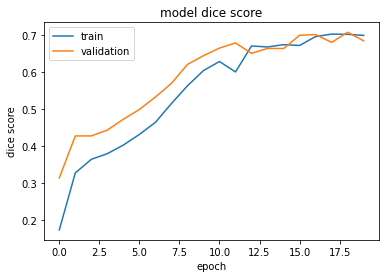

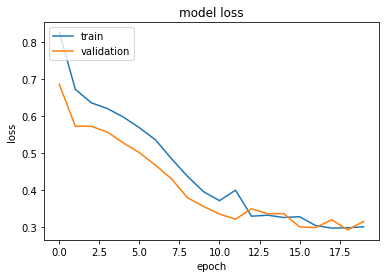

In [ ]:
model2 = UNetCompiled(n_filters = 4)
model2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = model2.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=6, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.6753508, shape=(), dtype=float32)


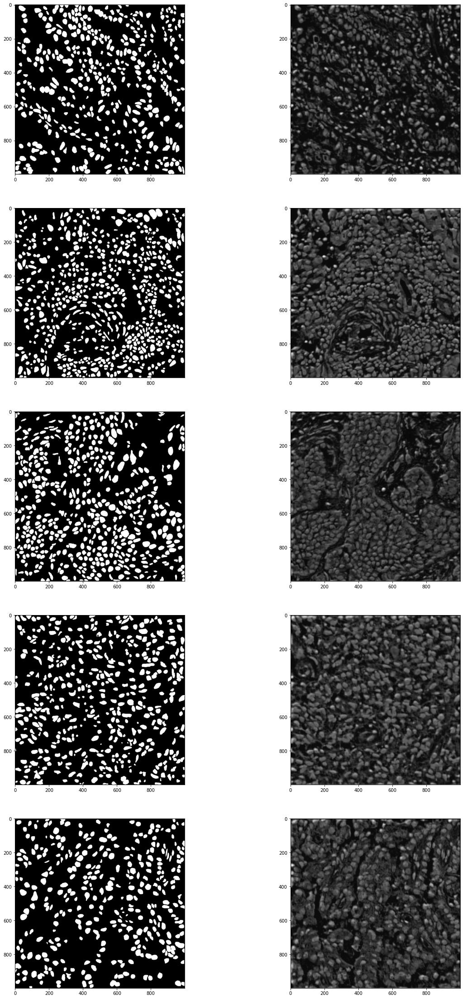

In [ ]:
predictions2 = model2.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictions2[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictions2)):
  sum_dice += dice_score(test_ds_y[i]/255, predictions2[i][:,:,0])

print(sum_dice/len(predictions2))

Epoch 1/10
8/8 [==============================] - 14s 2s/step - loss: 0.8852 - accuracy: 0.7451 - dice_score: 0.1148 - val_loss: 0.7383 - val_accuracy: 0.7008 - val_dice_score: 0.2617
Epoch 2/10
8/8 [==============================] - 13s 2s/step - loss: 0.6531 - accuracy: 0.4433 - dice_score: 0.3469 - val_loss: 0.5563 - val_accuracy: 0.2229 - val_dice_score: 0.4437
Epoch 3/10
8/8 [==============================] - 13s 2s/step - loss: 0.5996 - accuracy: 0.2467 - dice_score: 0.4004 - val_loss: 0.5027 - val_accuracy: 0.3097 - val_dice_score: 0.4973
Epoch 4/10
8/8 [==============================] - 13s 2s/step - loss: 0.5426 - accuracy: 0.4679 - dice_score: 0.4574 - val_loss: 0.4530 - val_accuracy: 0.5597 - val_dice_score: 0.5470
Epoch 5/10
8/8 [==============================] - 12s 2s/step - loss: 0.4991 - accuracy: 0.4861 - dice_score: 0.5009 - val_loss: 0.4167 - val_accuracy: 0.7625 - val_dice_score: 0.5833
Epoch 6/10
8/8 [==============================] - 12s 1s/step - loss: 0.4312 - a

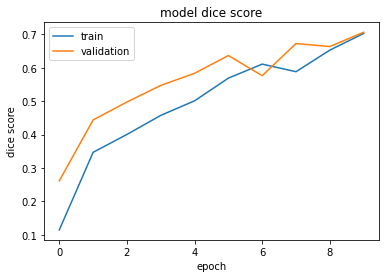

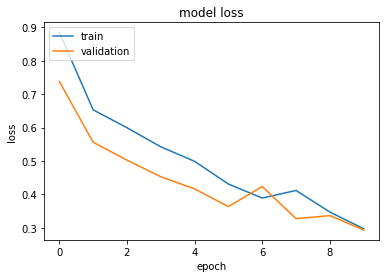

In [ ]:
model3 = UNetCompiled(n_filters = 32)
model3.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = model3.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=3, epochs=10, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.72630733, shape=(), dtype=float32)


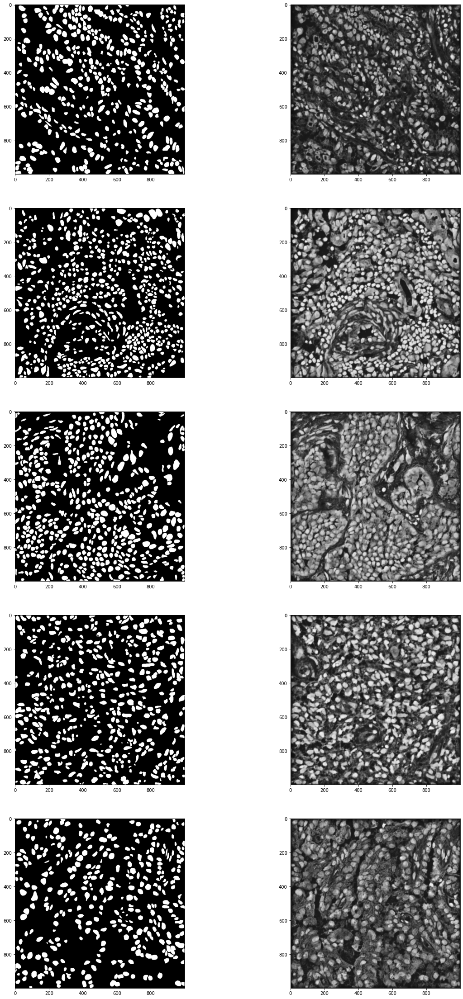

In [ ]:
predictions3 = model3.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictions3[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictions3)):
  sum_dice += dice_score(test_ds_y[i]/255, predictions3[i][:,:,0])

print(sum_dice/len(predictions3))

# Effect of Number of Blocks

In [ ]:
def UNetCompiled1(input_size=(1000, 1000, 3), n_filters=16, n_classes=1):
    inputs = Input(input_size)
    resized = tf.keras.layers.Resizing(1024,1024) (inputs)
   
    cblock1 = EncoderMiniBlock(resized, n_filters,dropout_prob=0, max_pooling=True)
    cblock2 = EncoderMiniBlock(cblock1[0],n_filters*2,dropout_prob=0, max_pooling=True)
    cblock3 = EncoderMiniBlock(cblock2[0], n_filters*4,dropout_prob=0, max_pooling=True)
    cblock4 = EncoderMiniBlock(cblock3[0], n_filters*8,dropout_prob=0.1, max_pooling=True)
    cblock5 = EncoderMiniBlock(cblock4[0], n_filters*16, dropout_prob=0.1, max_pooling=False)
    #cblock6 = EncoderMiniBlock(cblock5[0], n_filters*32, dropout_prob=0.1, max_pooling=False)
     
    
    #ublock5 = DecoderMiniBlock(cblock6[0], cblock5[1],  n_filters * 16)
    ublock6 = DecoderMiniBlock(cblock5[0], cblock4[1],  n_filters * 8)
    ublock7 = DecoderMiniBlock(ublock6, cblock3[1],  n_filters * 4)
    ublock8 = DecoderMiniBlock(ublock7, cblock2[1],  n_filters * 2)
    ublock9 = DecoderMiniBlock(ublock8, cblock1[1],  n_filters)

   
    conv9 = Conv2D(n_filters,
                 3,
                 activation='relu',
                 padding='same')(ublock9)

    conv10 = Conv2D(n_classes, 1, padding='same')(conv9)
    out = tf.keras.layers.Resizing(1000,1000)(conv10)

    model = tf.keras.Model(inputs=inputs, outputs=out)

    return model

Epoch 1/20
4/4 [==============================] - 26s 1s/step - loss: 0.8130 - accuracy: 0.6584 - dice_score: 0.1870 - val_loss: 0.6549 - val_accuracy: 0.1868 - val_dice_score: 0.3451
Epoch 2/20
4/4 [==============================] - 4s 1s/step - loss: 0.6527 - accuracy: 0.1927 - dice_score: 0.3473 - val_loss: 0.6248 - val_accuracy: 0.1712 - val_dice_score: 0.3752
Epoch 3/20
4/4 [==============================] - 4s 1s/step - loss: 0.5920 - accuracy: 0.2377 - dice_score: 0.4080 - val_loss: 0.5263 - val_accuracy: 0.2896 - val_dice_score: 0.4737
Epoch 4/20
4/4 [==============================] - 4s 1s/step - loss: 0.5468 - accuracy: 0.6158 - dice_score: 0.4532 - val_loss: 0.4701 - val_accuracy: 0.7242 - val_dice_score: 0.5299
Epoch 5/20
4/4 [==============================] - 4s 1s/step - loss: 0.4591 - accuracy: 0.5758 - dice_score: 0.5409 - val_loss: 0.3584 - val_accuracy: 0.7720 - val_dice_score: 0.6416
Epoch 6/20
4/4 [==============================] - 4s 1s/step - loss: 0.3549 - accura

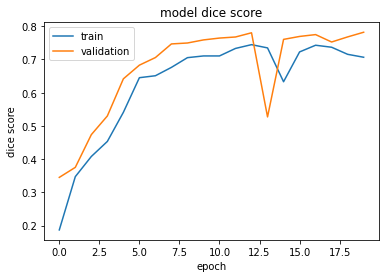

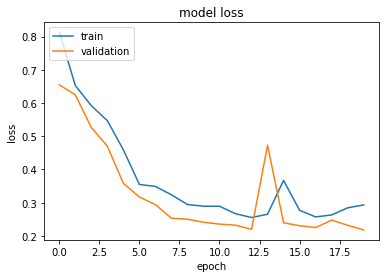

In [ ]:
modelb1 = UNetCompiled1()
modelb1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = modelb1.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=6, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.7580598, shape=(), dtype=float32)


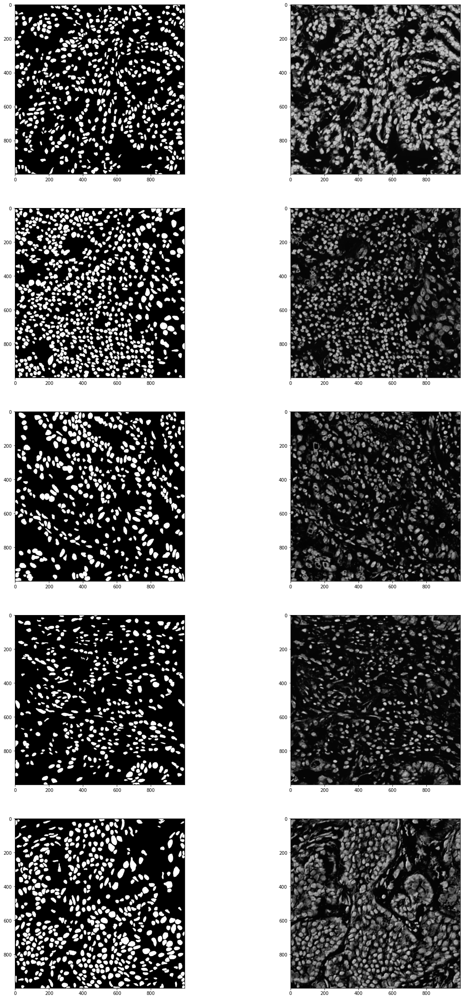

In [ ]:
predictionsb1 = modelb1.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictionsb1[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictionsb1)):
  sum_dice += dice_score(test_ds_y[i]/255, predictionsb1[i][:,:,0])

print(sum_dice/len(predictionsb1))

In [ ]:
def UNetCompiled2(input_size=(1000, 1000, 3), n_filters=16, n_classes=1):
    inputs = Input(input_size)
    resized = tf.keras.layers.Resizing(1024,1024) (inputs)
   
    cblock1 = EncoderMiniBlock(resized, n_filters,dropout_prob=0, max_pooling=True)
    cblock2 = EncoderMiniBlock(cblock1[0],n_filters*2,dropout_prob=0, max_pooling=True)
    cblock3 = EncoderMiniBlock(cblock2[0], n_filters*4,dropout_prob=0, max_pooling=True)
    cblock4 = EncoderMiniBlock(cblock3[0], n_filters*8,dropout_prob=0.1, max_pooling=True)
    cblock5 = EncoderMiniBlock(cblock4[0], n_filters*16, dropout_prob=0.1, max_pooling=True)
    cblock6 = EncoderMiniBlock(cblock5[0], n_filters*32, dropout_prob=0.1, max_pooling=True)
    cblock7 = EncoderMiniBlock(cblock6[0], n_filters*64, dropout_prob=0.1, max_pooling=False) 
    
    ublock4 = DecoderMiniBlock(cblock7[0], cblock6[1],  n_filters * 32)
    ublock5 = DecoderMiniBlock(ublock4, cblock5[1],  n_filters * 16)
    ublock6 = DecoderMiniBlock(ublock5, cblock4[1],  n_filters * 8)
    ublock7 = DecoderMiniBlock(ublock6, cblock3[1],  n_filters * 4)
    ublock8 = DecoderMiniBlock(ublock7, cblock2[1],  n_filters * 2)
    ublock9 = DecoderMiniBlock(ublock8, cblock1[1],  n_filters)

   
    conv9 = Conv2D(n_filters,
                 3,
                 activation='relu',
                 padding='same')(ublock9)

    conv10 = Conv2D(n_classes, 1, padding='same')(conv9)
    out = tf.keras.layers.Resizing(1000,1000)(conv10)

    model = tf.keras.Model(inputs=inputs, outputs=out)

    return model

Epoch 1/20
8/8 [==============================] - 9s 807ms/step - loss: 0.9742 - accuracy: 0.7451 - dice_score: 0.0258 - val_loss: 0.9171 - val_accuracy: 0.7008 - val_dice_score: 0.0829
Epoch 2/20
8/8 [==============================] - 6s 711ms/step - loss: 0.8451 - accuracy: 0.7451 - dice_score: 0.1549 - val_loss: 0.6654 - val_accuracy: 0.7008 - val_dice_score: 0.3346
Epoch 3/20
8/8 [==============================] - 6s 731ms/step - loss: 0.5916 - accuracy: 0.3905 - dice_score: 0.4084 - val_loss: 0.5260 - val_accuracy: 0.4271 - val_dice_score: 0.4740
Epoch 4/20
8/8 [==============================] - 6s 769ms/step - loss: 0.5720 - accuracy: 0.3467 - dice_score: 0.4280 - val_loss: 0.5026 - val_accuracy: 0.3025 - val_dice_score: 0.4974
Epoch 5/20
8/8 [==============================] - 6s 750ms/step - loss: 0.5494 - accuracy: 0.3869 - dice_score: 0.4506 - val_loss: 0.4824 - val_accuracy: 0.5226 - val_dice_score: 0.5176
Epoch 6/20
8/8 [==============================] - 6s 736ms/step - loss

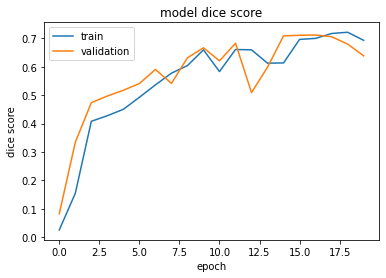

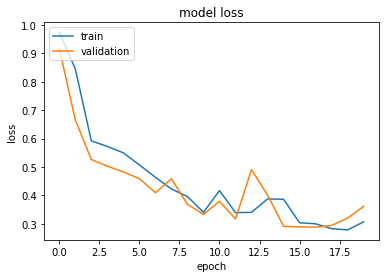

In [ ]:
modelb2 = UNetCompiled2()
modelb2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002) , loss=dice_loss, metrics=["accuracy", dice_score] )

history = modelb2.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=3, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.5055782, shape=(), dtype=float32)


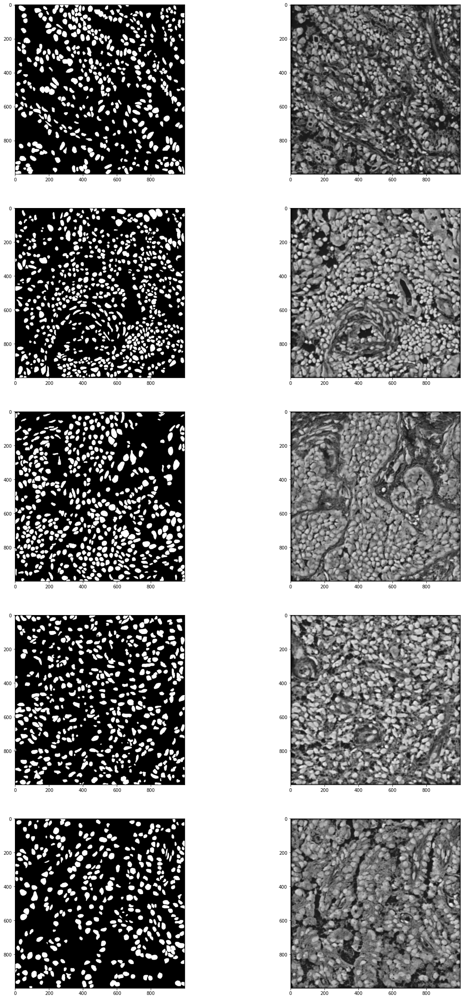

In [ ]:
predictionsb2 = modelb2.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictionsb2[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictionsb2)):
  sum_dice += dice_score(test_ds_y[i]/255, predictionsb2[i][:,:,0])

print(sum_dice/len(predictionsb2))

# Analysis with a Hybrid loss function

In [ ]:
def ms_ssim(mask1,mask2):
  ssim_img = tf.image.ssim(mask1,mask2,1, filter_size=5)
  return tf.reduce_mean(ssim_img*ssim_img)

In [ ]:
def hybrid_loss(mask1,mask2):
  return tf.maximum(ms_ssim(mask1,mask2),dice_loss(mask1,mask2))

Epoch 1/20
4/4 [==============================] - 9s 2s/step - loss: 0.8884 - accuracy: 0.7451 - dice_score: 0.1116 - val_loss: 0.7709 - val_accuracy: 0.3037 - val_dice_score: 0.2291
Epoch 2/20
4/4 [==============================] - 5s 1s/step - loss: 0.6465 - accuracy: 0.2729 - dice_score: 0.3535 - val_loss: 0.5139 - val_accuracy: 0.6791 - val_dice_score: 0.4861
Epoch 3/20
4/4 [==============================] - 5s 1s/step - loss: 0.5416 - accuracy: 0.7279 - dice_score: 0.4584 - val_loss: 0.4731 - val_accuracy: 0.6635 - val_dice_score: 0.5269
Epoch 4/20
4/4 [==============================] - 5s 1s/step - loss: 0.4797 - accuracy: 0.6681 - dice_score: 0.5203 - val_loss: 0.3921 - val_accuracy: 0.6970 - val_dice_score: 0.6079
Epoch 5/20
4/4 [==============================] - 5s 1s/step - loss: 0.3649 - accuracy: 0.7825 - dice_score: 0.6351 - val_loss: 0.3061 - val_accuracy: 0.7822 - val_dice_score: 0.6939
Epoch 6/20
4/4 [==============================] - 5s 1s/step - loss: 0.3129 - accurac

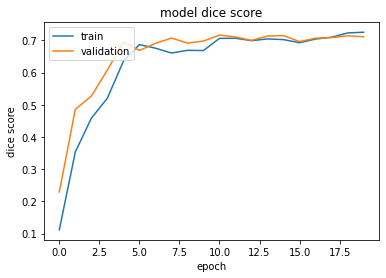

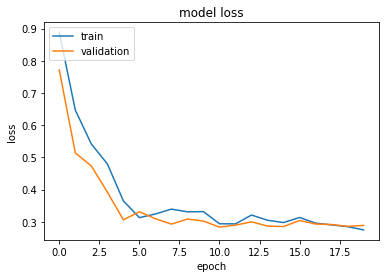

In [ ]:
modelb1 = UNetCompiled1()
modelb1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002) , loss=hybrid_loss, metrics=["accuracy", dice_score] )

history = modelb1.fit(np.array(train_ds[0]), np.array(train_ds[1]), batch_size=6, epochs=20, validation_split=0.2)

plt.plot(history.history['dice_score'])
plt.plot(history.history['val_dice_score'])
plt.title('model dice score')
plt.ylabel('dice score')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

tf.Tensor(0.68465155, shape=(), dtype=float32)


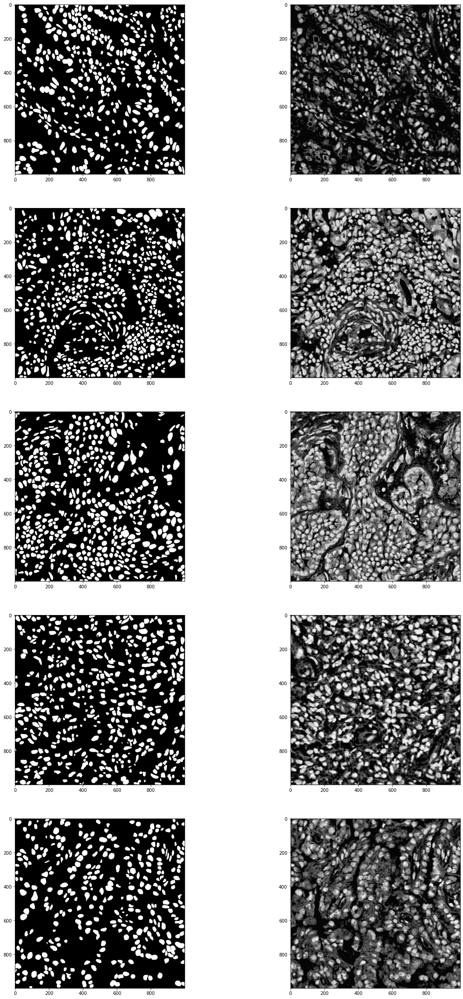

In [ ]:
predictions_hyb = modelb1.predict_on_batch(np.array(test_ds_x)/255)
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(predictions_hyb[i][:,:,0], cmap="gray")
    
fig.show()
sum_dice = 0
test_ds_y = np.clip(test_ds_y, 0, 255)
for i in range(len(predictions_hyb)):
  sum_dice += dice_score(test_ds_y[i]/255, predictions_hyb[i][:,:,0])

print(sum_dice/len(predictions_hyb))

# Watershed Segmentation

In [ ]:
thresh_outs = []
for img in predictionsb1:
  ret, thresh = cv2.threshold(img*255, 150, 255, cv2.THRESH_BINARY)
  thresh_outs.append(thresh)

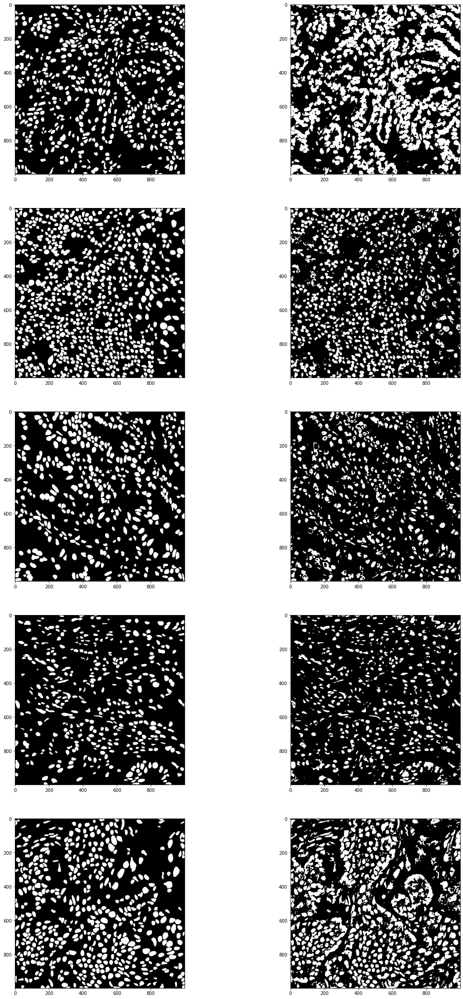

In [ ]:
fig, ax = plt.subplots(5, 2, figsize=(20,40))
for i in range(5):
    # ax.set_xticks([]); ax.set_yticks([])
    ax[i,0].imshow(test_ds_y[i], cmap="gray")
    ax[i,1].imshow(thresh_outs[i], cmap="gray")
    
fig.show()

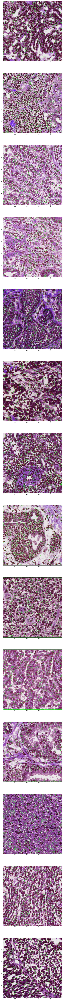

In [ ]:
fig, ax = plt.subplots(len(thresh_outs), 1, figsize=(200,200))
for i in range(len(thresh_outs)):
  img = thresh_outs[i]
  kernel = np.ones((3,3),np.uint8)
  opening = cv2.morphologyEx(img,cv2.MORPH_OPEN,kernel, iterations = 2)
  closing = cv2.morphologyEx(img,cv2.MORPH_CLOSE,kernel, iterations = 2)
  # sure background area
  sure_bg = cv2.dilate(closing,kernel,iterations=3)
  # Finding sure foreground area
  # print(opening.shape)
  sure_bg = sure_bg.astype("uint8")
  dist_transform = cv2.distanceTransform(sure_bg,cv2.DIST_L2,5)
  # Threshold
  ret, sure_fg = cv2.threshold(dist_transform,0.1*dist_transform.max(),255,0)

  # Finding unknown region
  sure_fg = np.uint8(sure_fg)
  unknown = cv2.subtract(sure_bg,sure_fg)

  # Marker labelling
  ret, markers = cv2.connectedComponents(sure_fg)
  # Add one to all labels so that sure background is not 0, but 1
  markers = markers+1
  # Now, mark the region of unknown with zero
  markers[unknown==255] = 0

  org_img = test_ds_x[i].copy()
  markers = cv2.watershed(org_img,markers)
  org_img[markers == -1] = [0,255,0]
  ax[i].imshow(org_img)
  

